# AML Project - Data analysis with Trees

In [1]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"
import pandas as pd
import numpy as np
import os
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV
from os.path import isdir, join
from os import mkdir
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix,accuracy_score, classification_report, f1_score

np.random.seed(18091998)

In [2]:
# Returns a DataFrame containing the 'df' numeric variables
def numeric(df):
    return df.select_dtypes(include = np.number)

# Returns a DataFrame containing the 'df' categorical variables
def categoric(df):
    return df.select_dtypes(include = 'object')

def replace_categories_with_numbers(df, standard = True, lesion = True):
    replacements = []
    # Loading replacements of standard categories
    if standard:
        with open('./data/categories.txt', mode = 'r') as file:
            for line in file: 
                var, categories = line.strip().split(':')
                if var in df:
                    replacements.append((var, categories.split()))
    # Loading replacements of derived categories (lesion)
    if lesion:
        with open('./data/categories-lesion.txt', mode = 'r') as file:
            for line in file: 
                var, categories = line.strip().split(':')
                if var in df:
                    replacements.append((var, categories.split()))
    # Replacing categories
    for var, categories in replacements:
        to_replace = {cat:idx for idx, cat in enumerate(categories)}
        df[var].replace(to_replace, inplace = True)
        df[var] = df[var].astype(object)

In [3]:
def compute_metrics(y_true,y_pred):
    accuracy = accuracy_score(y_true,y_pred)
    f1_score_macro = f1_score(y_true,y_pred,average='macro')
    return [accuracy,f1_score_macro]
    
def confusion(true, pred):
    pred = pd.Series(pred)
    true = pd.Series(true)
    
    true.name = 'target'
    pred.name = 'predicted'
    cm = pd.crosstab(true.reset_index(drop=True), pred.reset_index(drop=True))
    cm = cm[cm.index]
    return cm

results = pd.DataFrame(columns=['Accuracy', 'F1-score (macro avg)'])

# Random Forests

In [128]:
# Loading train data
train = pd.read_csv('./data/preprocessed/train.csv')
train_data = train.iloc[:,:24]
train_label = train.iloc[:,24:25]

replace_categories_with_numbers(train_data)

# Loading test data
test = pd.read_csv('./data/preprocessed/test.csv')
test_data = test.iloc[:,:24]
test_label = test.iloc[:,24:25]

replace_categories_with_numbers(test_data)

In [127]:
# Naive example
model1 = RandomForestClassifier(random_state = np.random.seed(18091998))
model1.fit(train_data, np.ravel(train_label))
model1.score(train_data, train_label)

test_predicted = model1.predict(test_data)

confusion_matrix(test_label,test_predicted)
report = classification_report(test_label,test_predicted, output_dict=True)
df = pd.DataFrame(report).transpose()
df

RandomForestClassifier()

1.0

array([[ 6,  2,  4],
       [ 1,  2,  5],
       [ 5,  2, 40]])

,precision,recall,f1-score,support
died,0.500000,0.500000,0.500000,12.000000
euthanized,0.333333,0.250000,0.285714,8.000000
lived,0.816327,0.851064,0.833333,47.000000
accuracy,0.716418,0.716418,0.716418,0.716418
macro avg,0.549887,0.533688,0.539683,67.000000
weighted avg,0.702000,0.716418,0.708244,67.000000


In [84]:
scoring_cols = [
    'param_n_estimators','param_max_depth', 'param_min_samples_leaf', 'param_min_samples_split',
    'param_max_features','param_class_weight',
    'mean_test_f1_mac', 
    'mean_test_acc'
]

model2 = RandomForestClassifier()

scoring_dict = {
    'f1_mac': 'f1_macro',
    'acc': 'accuracy'
}

ntrees = [10, 50, 100, 150, 200]
max_depths = [100, 125, 150, 200, None]
min_samples_leaf = [2, 3, 4, 5, 6]
min_samples_split = [2, 3, 4, 5, 6]
max_features = [5,'sqrt', 'log2', None]
random_state = [np.random.seed(18091998)]

balance = [None, 'balanced']

grid = GridSearchCV(estimator=model2,
                   scoring=scoring_dict,
                   param_grid={
                       'n_estimators': ntrees,
                       'max_depth':max_depths,
                       'min_samples_split':min_samples_split,
                       'min_samples_leaf':min_samples_leaf, 
                       'class_weight':balance,
                       'max_features':max_features,
                       'random_state':random_state
                   },
                   cv=10,
                   return_train_score=False,
                   refit=False,
                   n_jobs=-1,
                   verbose=2)                  
                  
model_10CV = grid.fit(train_data, np.ravel(train_label))
os.system("printf '\a'")

Fitting 10 folds for each of 5000 candidates, totalling 50000 fits
[CV] END class_weight=None, max_depth=100, max_features=5, min_samples_leaf=2, min_samples_split=2, n_estimators=10, random_state=None; total time=   0.0s
[CV] END class_weight=None, max_depth=100, max_features=5, min_samples_leaf=2, min_samples_split=2, n_estimators=10, random_state=None; total time=   0.1s
[CV] END class_weight=None, max_depth=100, max_features=5, min_samples_leaf=2, min_samples_split=2, n_estimators=50, random_state=None; total time=   0.3s
[CV] END class_weight=None, max_depth=100, max_features=5, min_samples_leaf=2, min_samples_split=2, n_estimators=50, random_state=None; total time=   0.2s
[CV] END class_weight=None, max_depth=100, max_features=5, min_samples_leaf=2, min_samples_split=2, n_estimators=50, random_state=None; total time=   0.1s
[CV] END class_weight=None, max_depth=100, max_features=5, min_samples_leaf=2, min_samples_split=2, n_estimators=100, random_state=None; total time=   0.3s
[C

0

In [88]:
acc = pd.DataFrame(model_10CV.cv_results_).sort_values(
    by='mean_test_acc', ascending=False)[scoring_cols].head(100)
f1 = pd.DataFrame(model_10CV.cv_results_).sort_values(
    by='mean_test_f1_mac', ascending=False)[scoring_cols].head(100)

In [89]:
acc

,param_n_estimators,param_max_depth,param_min_samples_leaf,param_min_samples_split,param_max_features,param_class_weight,mean_test_f1_mac,mean_test_acc
4507,100,None,2,3,5,balanced,0.704740,0.779425
3754,200,150,2,2,log2,balanced,0.698998,0.779310
4638,150,None,2,4,sqrt,balanced,0.703128,0.779310
4134,200,200,2,3,sqrt,balanced,0.706512,0.779195
886,50,125,2,4,None,None,0.696697,0.776092
...,...,...,...,...,...,...,...,...
1282,100,150,3,3,log2,None,0.665243,0.765977
17,100,100,2,5,5,None,0.657447,0.765977
3252,100,125,2,2,log2,balanced,0.678446,0.765977
882,100,125,2,3,None,None,0.686542,0.765977


In [129]:
model2 = RandomForestClassifier(n_estimators=100,
                                max_depth=None,
                                min_samples_leaf=2,
                                min_samples_split=3,
                                max_features=5,
                                class_weight="balanced",
                                random_state = np.random.seed(18091998))
model2.fit(train_data, np.ravel(train_label))
model2.score(train_data, train_label)

test_predicted = model2.predict(test_data)

confusion_matrix(test_label,test_predicted)
report = classification_report(test_label,test_predicted, output_dict=True)
df = pd.DataFrame(report).transpose()
df

RandomForestClassifier(class_weight='balanced', max_features=5,
                       min_samples_leaf=2, min_samples_split=3)

0.979933110367893

array([[ 6,  2,  4],
       [ 1,  4,  3],
       [ 5,  3, 39]])

,precision,recall,f1-score,support
died,0.500000,0.500000,0.500000,12.000000
euthanized,0.444444,0.500000,0.470588,8.000000
lived,0.847826,0.829787,0.838710,47.000000
accuracy,0.731343,0.731343,0.731343,0.731343
macro avg,0.597424,0.609929,0.603099,67.000000
weighted avg,0.737364,0.731343,0.734090,67.000000


In [130]:
results.loc['RF-all',:] = compute_metrics(test_label, test_predicted)
results

,Accuracy,F1-score (macro avg)
RF-all,0.731343,0.603099


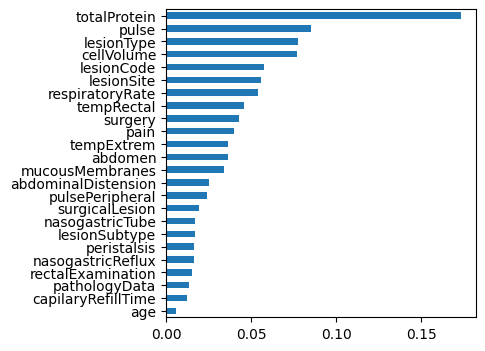

In [113]:
var_imp = pd.DataFrame({'importance': model2.feature_importances_},
                       index=train_data.columns)

var_imp.sort_values(by='importance').plot.barh(figsize=(4,4), legend=False);

## Reducing dataset

Now we will try the same approach but deleting the variables with > 1/3 missings

In [131]:
# Loading train data
train = pd.read_csv('./data/preprocessed/train.csv')

train_data = train.iloc[:,:24].drop(['nasogastricTube','nasogastricReflux','rectalExamination', 'abdomen'], axis=1)
train_data
train_label = train.outcome

replace_categories_with_numbers(train_data)

# Loading test data
test = pd.read_csv('./data/preprocessed/test.csv')
test_data = test.iloc[:,:24].drop(['nasogastricTube','nasogastricReflux','rectalExamination', 'abdomen'], axis=1)
test_label = test.outcome

replace_categories_with_numbers(test_data)

,surgery,age,tempRectal,pulse,respiratoryRate,tempExtrem,pulsePeripheral,mucousMembranes,capilaryRefillTime,pain,peristalsis,abdominalDistension,cellVolume,totalProtein,surgicalLesion,pathologyData,lesionSite,lesionType,lesionSubtype,lesionCode
0,no,adult,38.5,66.0,2.928317,cool,reduced,paleCyanotic,>=3,continuousSevere,absent,severe,2.682090,8.4,no,no,allIntestinalSites,inflamation,none,none
1,yes,adult,39.2,88.0,2.666497,cool,reduced,paleCyanotic,<3,intermittentMild,absent,slight,2.731518,85.0,no,no,intestine,strangulation,none,hernia
2,no,adult,38.3,40.0,2.809234,normal,normal,palePink,<3,intermittentMild,hypomotile,none,2.530512,6.7,no,yes,none,none,none,none
3,yes,young,39.1,164.0,3.736134,cold,normal,darkCyanotic,>=3,depressed,absent,severe,2.712488,7.2,yes,yes,intestine,strangulation,none,hernia
4,no,adult,37.3,104.0,3.098140,cool,reduced,darkCyanotic,>=3,continuousSevere,absent,severe,2.906725,7.4,no,no,colonCecum,inflamation,none,none
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
294,yes,adult,38.8,120.0,3.606895,cold,reduced,paleCyanotic,>=3,depressed,absent,moderate,2.775361,65.0,no,no,colon,strangulation,none,torsion
295,no,adult,37.2,72.0,2.809234,cool,increased,paleCyanotic,>=3,intermittentSevere,hypomotile,moderate,2.671414,8.8,yes,yes,intestine,strangulation,none,hernia
296,yes,adult,37.5,72.0,2.981146,cold,reduced,paleCyanotic,<3,intermittentSevere,absent,moderate,2.814676,6.8,yes,no,colon,strangulation,none,torsion
297,yes,adult,36.5,100.0,2.809234,cool,reduced,palePink,<3,intermittentMild,hypomotile,moderate,2.731518,6.0,yes,yes,intestine,strangulation,none,hernia


In [95]:
scoring_cols = [
    'param_n_estimators','param_max_depth', 'param_min_samples_leaf', 'param_min_samples_split',
    'param_max_features','param_class_weight',
    'mean_test_f1_mac', 
    'mean_test_acc'
]

model3 = RandomForestClassifier()

scoring_dict = {
    'f1_mac': 'f1_macro',
    'acc': 'accuracy'
}

ntrees = [10, 50, 100, 150, 200]
max_depths = [100, 125, 150, 200, None]
min_samples_leaf = [2, 3, 4, 5, 6]
min_samples_split = [2, 3, 4, 5, 6]
max_features = [5,'sqrt', 'log2', None]
random_state = [np.random.seed(18091998)]

balance = [None, 'balanced']

grid = GridSearchCV(estimator=model3,
                   scoring=scoring_dict,
                   param_grid={
                       'n_estimators': ntrees,
                       'max_depth':max_depths,
                       'min_samples_split':min_samples_split,
                       'min_samples_leaf':min_samples_leaf, 
                       'class_weight':balance,
                       'max_features':max_features,
                       'random_state':random_state
                   },
                   cv=10,
                   return_train_score=False,
                   refit=False,
                   n_jobs=-1,
                   verbose=2)                  
                  
model3_10CV = grid.fit(train_data, np.ravel(train_label))
os.system("printf '\a'")

Fitting 10 folds for each of 5000 candidates, totalling 50000 fits
[CV] END class_weight=None, max_depth=100, max_features=5, min_samples_leaf=2, min_samples_split=2, n_estimators=10, random_state=None; total time=   0.0s
[CV] END class_weight=None, max_depth=100, max_features=5, min_samples_leaf=2, min_samples_split=2, n_estimators=10, random_state=None; total time=   0.1s
[CV] END class_weight=None, max_depth=100, max_features=5, min_samples_leaf=2, min_samples_split=2, n_estimators=10, random_state=None; total time=   0.0s
[CV] END class_weight=None, max_depth=100, max_features=5, min_samples_leaf=2, min_samples_split=2, n_estimators=50, random_state=None; total time=   0.2s
[CV] END class_weight=None, max_depth=100, max_features=5, min_samples_leaf=2, min_samples_split=2, n_estimators=50, random_state=None; total time=   0.2s
[CV] END class_weight=None, max_depth=100, max_features=5, min_samples_leaf=2, min_samples_split=2, n_estimators=100, random_state=None; total time=   0.4s
[C

0

[CV] END class_weight=balanced, max_depth=None, max_features=None, min_samples_leaf=2, min_samples_split=6, n_estimators=150, random_state=None; total time=   0.5s
[CV] END class_weight=balanced, max_depth=None, max_features=None, min_samples_leaf=2, min_samples_split=6, n_estimators=150, random_state=None; total time=   0.5s
[CV] END class_weight=balanced, max_depth=None, max_features=None, min_samples_leaf=2, min_samples_split=6, n_estimators=200, random_state=None; total time=   0.6s
[CV] END class_weight=balanced, max_depth=None, max_features=None, min_samples_leaf=2, min_samples_split=6, n_estimators=200, random_state=None; total time=   0.6s
[CV] END class_weight=balanced, max_depth=None, max_features=None, min_samples_leaf=3, min_samples_split=2, n_estimators=10, random_state=None; total time=   0.0s
[CV] END class_weight=balanced, max_depth=None, max_features=None, min_samples_leaf=3, min_samples_split=2, n_estimators=10, random_state=None; total time=   0.0s
[CV] END class_wei

In [99]:
acc3 = pd.DataFrame(model3_10CV.cv_results_).sort_values(
    by='mean_test_acc', ascending=False)[scoring_cols].head(100)
f13 = pd.DataFrame(model3_10CV.cv_results_).sort_values(
    by='mean_test_f1_mac', ascending=False)[scoring_cols].head(100)
acc3

,param_n_estimators,param_max_depth,param_min_samples_leaf,param_min_samples_split,param_max_features,param_class_weight,mean_test_f1_mac,mean_test_acc
3766,50,150,2,5,log2,balanced,0.711362,0.782529
31,50,100,3,3,5,None,0.686150,0.775977
4753,150,None,2,2,log2,balanced,0.701204,0.772759
56,50,100,4,3,5,None,0.680722,0.772644
1008,150,150,2,3,5,None,0.680942,0.772644
...,...,...,...,...,...,...,...,...
629,200,125,2,2,sqrt,None,0.665944,0.762644
73,150,100,4,6,5,None,0.670814,0.762644
2348,150,None,5,6,log2,None,0.664072,0.762644
1677,100,200,4,2,sqrt,None,0.666562,0.762644


In [132]:
model3 = RandomForestClassifier(n_estimators=50,
                                max_depth=150,
                                min_samples_leaf=2,
                                min_samples_split=5,
                                max_features="log2",
                                class_weight="balanced",
                                random_state = np.random.seed(18091998))
model3.fit(train_data, np.ravel(train_label))
model3.score(train_data, train_label)

test_predicted = model3.predict(test_data)

confusion_matrix(test_label,test_predicted)
report = classification_report(test_label,test_predicted, output_dict=True)
df = pd.DataFrame(report).transpose()
df

RandomForestClassifier(class_weight='balanced', max_depth=150,
                       max_features='log2', min_samples_leaf=2,
                       min_samples_split=5, n_estimators=50)

0.9565217391304348

array([[ 5,  3,  4],
       [ 1,  5,  2],
       [ 5,  4, 38]])

,precision,recall,f1-score,support
died,0.454545,0.416667,0.434783,12.000000
euthanized,0.416667,0.625000,0.500000,8.000000
lived,0.863636,0.808511,0.835165,47.000000
accuracy,0.716418,0.716418,0.716418,0.716418
macro avg,0.578283,0.616726,0.589982,67.000000
weighted avg,0.736997,0.716418,0.723435,67.000000


In [133]:
results.loc['RF-reduced',:] = compute_metrics(test_label, test_predicted)
results

,Accuracy,F1-score (macro avg)
RF-all,0.731343,0.603099
RF-reduced,0.716418,0.589982


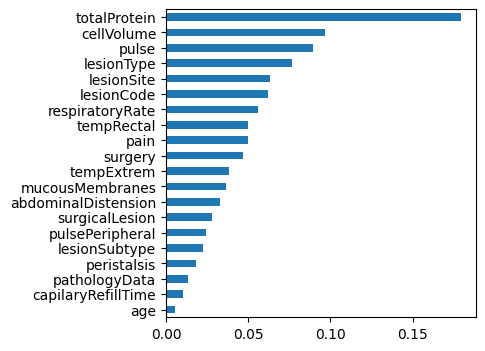

In [120]:
var_imp = pd.DataFrame({'importance': model3.feature_importances_},
                       index=train_data.columns)

var_imp.sort_values(by='importance').plot.barh(figsize=(4,4), legend=False);

## Decision Trees

In [15]:
# Loading train data
train = pd.read_csv('./data/preprocessed/train.csv')
train_data = train.iloc[:,:24]
train_label = train.iloc[:,24:25]

replace_categories_with_numbers(train_data)

# Loading test data
test = pd.read_csv('./data/preprocessed/test.csv')
test_data = test.iloc[:,:24]
test_label = test.iloc[:,24:25]

replace_categories_with_numbers(test_data)

In [ ]:
criterion = ['gini', 'entropy']
max_depths = np.arange(1,100,10).tolist()
min_samples_split = np.arange(1,20,2).tolist()
min_samples_leaf = np.arange(1,40,4).tolist()
max_features = [None, 'log2']
balance = [None, 'balanced']
random_state = [np.random.seed(18091998)]

model = DecisionTreeClassifier()

grid = GridSearchCV(estimator=model,
                   scoring=scoring_dict,
                   param_grid={
                       'criterion': criterion,
                       'max_depth': max_depths,
                       'min_samples_split': min_samples_split,
                       'min_samples_leaf': min_samples_leaf,
                       'max_features': max_features,
                       'class_weight': balance,
                       'random_state':random_state
                   },
                   cv=10,
                   return_train_score=False,
                   refit=False,
                   verbose=2)

model_DT_10CV = grid.fit(train_data, train_label)

Fitting 10 folds for each of 8000 candidates, totalling 80000 fits
[CV] END class_weight=None, criterion=gini, max_depth=1, max_features=None, min_samples_leaf=1, min_samples_split=1, random_state=None; total time=   0.0s
[CV] END class_weight=None, criterion=gini, max_depth=1, max_features=None, min_samples_leaf=1, min_samples_split=1, random_state=None; total time=   0.0s
[CV] END class_weight=None, criterion=gini, max_depth=1, max_features=None, min_samples_leaf=1, min_samples_split=1, random_state=None; total time=   0.0s
[CV] END class_weight=None, criterion=gini, max_depth=1, max_features=None, min_samples_leaf=1, min_samples_split=1, random_state=None; total time=   0.0s
[CV] END class_weight=None, criterion=gini, max_depth=1, max_features=None, min_samples_leaf=1, min_samples_split=1, random_state=None; total time=   0.0s
[CV] END class_weight=None, criterion=gini, max_depth=1, max_features=None, min_samples_leaf=1, min_samples_split=1, random_state=None; total time=   0.0s
[CV

In [148]:
scoring_cols = [
    'param_criterion', 'param_max_depth', 'param_max_features',
    'param_min_samples_leaf', 'param_min_samples_split', 'param_class_weight', 'mean_test_f1_mac', 'mean_test_acc'
]
acc_DT = pd.DataFrame(model_DT_10CV.cv_results_).sort_values(
    by='mean_test_acc', ascending=False)[scoring_cols].head(10)
acc_DT

,param_criterion,param_max_depth,param_max_features,param_min_samples_leaf,param_min_samples_split,param_class_weight,mean_test_f1_mac,mean_test_acc
1265,gini,61,None,25,11,None,0.668937,0.735862
268,gini,11,None,25,17,None,0.668937,0.735862
869,gini,41,None,25,19,None,0.668937,0.735862
1261,gini,61,None,25,3,None,0.668937,0.735862
1262,gini,61,None,25,5,None,0.668937,0.735862
1263,gini,61,None,25,7,None,0.668937,0.735862
868,gini,41,None,25,17,None,0.668937,0.735862
1264,gini,61,None,25,9,None,0.668937,0.735862
1863,gini,91,None,25,7,None,0.668937,0.735862
1266,gini,61,None,25,13,None,0.668937,0.735862


In [16]:
best_DT = DecisionTreeClassifier(criterion="gini",
                                max_depth=61,
                                min_samples_leaf=25,
                                min_samples_split=11,
                                max_features=None,
                                class_weight=None,
                                random_state = np.random.seed(18091998))
best_DT.fit(train_data, np.ravel(train_label))
best_DT.score(train_data, train_label)

test_predicted = best_DT.predict(test_data)
results.loc['DT-all',:] = compute_metrics(test_label, test_predicted)
results

DecisionTreeClassifier(max_depth=61, min_samples_leaf=25, min_samples_split=11)

0.745819397993311

,Accuracy,F1-score (macro avg)
DT-all,0.731343,0.618968
DT-reduced,0.731343,0.618968


## Decision Trees with reduced dataset

In [17]:
# Loading train data
train = pd.read_csv('./data/preprocessed/train.csv')
train_data = train.iloc[:,:24].drop(['nasogastricTube','nasogastricReflux','rectalExamination', 'abdomen'], axis=1)
train_label = train.outcome

replace_categories_with_numbers(train_data)

# Loading test data
test = pd.read_csv('./data/preprocessed/test.csv')
test_data = test.iloc[:,:24].drop(['nasogastricTube','nasogastricReflux','rectalExamination', 'abdomen'], axis=1)
test_label = test.outcome

replace_categories_with_numbers(test_data)

In [10]:
scoring_dict = {
    'f1_mac': 'f1_macro',
    'acc': 'accuracy'
}
criterion = ['gini', 'entropy']
max_depths = np.arange(1,100,10).tolist()
min_samples_split = np.arange(1,20,2).tolist()
min_samples_leaf = np.arange(1,40,4).tolist()
max_features = [None, 'log2']
balance = [None, 'balanced']
random_state = [np.random.seed(18091998)]

model = DecisionTreeClassifier()

grid = GridSearchCV(estimator=model,
                   scoring=scoring_dict,
                   param_grid={
                       'criterion': criterion,
                       'max_depth': max_depths,
                       'min_samples_split': min_samples_split,
                       'min_samples_leaf': min_samples_leaf,
                       'max_features': max_features,
                       'class_weight': balance,
                       'random_state':random_state
                   },
                   cv=10,
                   return_train_score=False,
                   refit=False,
                   verbose=2)

model_DT_10CV = grid.fit(train_data, train_label)

Fitting 10 folds for each of 8000 candidates, totalling 80000 fits
[CV] END class_weight=None, criterion=gini, max_depth=1, max_features=None, min_samples_leaf=1, min_samples_split=1, random_state=None; total time=   0.0s
[CV] END class_weight=None, criterion=gini, max_depth=1, max_features=None, min_samples_leaf=1, min_samples_split=1, random_state=None; total time=   0.0s
[CV] END class_weight=None, criterion=gini, max_depth=1, max_features=None, min_samples_leaf=1, min_samples_split=1, random_state=None; total time=   0.0s
[CV] END class_weight=None, criterion=gini, max_depth=1, max_features=None, min_samples_leaf=1, min_samples_split=1, random_state=None; total time=   0.0s
[CV] END class_weight=None, criterion=gini, max_depth=1, max_features=None, min_samples_leaf=1, min_samples_split=1, random_state=None; total time=   0.0s
[CV] END class_weight=None, criterion=gini, max_depth=1, max_features=None, min_samples_leaf=1, min_samples_split=1, random_state=None; total time=   0.0s
[CV

In [11]:
scoring_cols = [
    'param_criterion', 'param_max_depth', 'param_max_features',
    'param_min_samples_leaf', 'param_min_samples_split', 'param_class_weight', 'mean_test_f1_mac', 'mean_test_acc'
]
acc_DT = pd.DataFrame(model_DT_10CV.cv_results_).sort_values(
    by='mean_test_acc', ascending=False)[scoring_cols].head(10)
acc_DT

,param_criterion,param_max_depth,param_max_features,param_min_samples_leaf,param_min_samples_split,param_class_weight,mean_test_f1_mac,mean_test_acc
1069,gini,51,None,25,19,None,0.668937,0.735862
462,gini,21,None,25,5,None,0.668937,0.735862
1863,gini,91,None,25,7,None,0.668937,0.735862
1864,gini,91,None,25,9,None,0.668937,0.735862
1269,gini,61,None,25,19,None,0.668937,0.735862
1268,gini,61,None,25,17,None,0.668937,0.735862
1267,gini,61,None,25,15,None,0.668937,0.735862
1266,gini,61,None,25,13,None,0.668937,0.735862
1265,gini,61,None,25,11,None,0.668937,0.735862
1264,gini,61,None,25,9,None,0.668937,0.735862


In [18]:
best_DT = DecisionTreeClassifier(criterion="gini",
                                max_depth=51,
                                min_samples_leaf=25,
                                min_samples_split=19,
                                max_features=None,
                                class_weight=None,
                                random_state = np.random.seed(18091998))
best_DT.fit(train_data, np.ravel(train_label))
best_DT.score(train_data, train_label)

test_predicted = best_DT.predict(test_data)
results.loc['DT-reduced',:] = compute_metrics(test_label, test_predicted)
results

DecisionTreeClassifier(max_depth=51, min_samples_leaf=25, min_samples_split=19)

0.745819397993311

,Accuracy,F1-score (macro avg)
DT-all,0.731343,0.618968
DT-reduced,0.731343,0.618968
